# GÁN NHÃN TỰ ĐỘNG/BÁN TỰ ĐỘNG CHO STARDIST

Notebook này cung cấp nhiều phương pháp để tạo annotations tự động, giảm thiểu công việc thủ công.

## 🎯 CÁC PHƯƠNG PHÁP:

1. **Pre-trained StarDist** (NHANH NHẤT, KHUYẾN NGHỊ)
2. **Cellpose** (Mạnh mẽ, đa năng)
3. **Traditional CV** (Threshold + Watershed)

Sau khi tạo annotations tự động, bạn chỉ cần **kiểm tra và chỉnh sửa** những chỗ sai thay vì vẽ lại từ đầu!

## ⚠️ BƯỚC 1: CÀI ĐẶT CÁC THỨ VIỆN CẦN THIẾT

**QUAN TRỌNG**: Chạy cell dưới để cài đặt các packages cần thiết trước khi tiếp tục!

In [1]:
# Cài đặt các packages cần thiết
# Chỉ cần chạy 1 lần

import sys
import subprocess

def install_packages():
    packages = [
        'stardist',
        'csbdeep',
        'tensorflow',
        'scikit-image',
        'scipy',
        'tqdm',
        'pandas'
    ]
    
    print("Đang cài đặt các packages cần thiết...")
    print("Quá trình này có thể mất vài phút...\n")
    
    for package in packages:
        print(f"Cài đặt {package}...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", "-q", package])
    
    print("\n✅ Đã cài đặt xong tất cả packages!")
    print("Bây giờ bạn có thể chạy các cells tiếp theo.")

# Uncomment dòng dưới và chạy cell này nếu cần cài đặt
install_packages()

print("⚠️ Nếu gặp lỗi import, uncomment dòng cuối và chạy lại cell này để cài đặt packages.")

Đang cài đặt các packages cần thiết...
Quá trình này có thể mất vài phút...

Cài đặt stardist...
Cài đặt csbdeep...
Cài đặt tensorflow...
Cài đặt scikit-image...
Cài đặt scipy...
Cài đặt tqdm...
Cài đặt pandas...

✅ Đã cài đặt xong tất cả packages!
Bây giờ bạn có thể chạy các cells tiếp theo.
⚠️ Nếu gặp lỗi import, uncomment dòng cuối và chạy lại cell này để cài đặt packages.


In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from pathlib import Path
from PIL import Image
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

plt.rcParams['figure.figsize'] = (15, 10)

## 📂 Load ảnh cần gán nhãn

In [3]:
# Đường dẫn
data_dir = Path('my_dataset/to_annotate')
images_dir = data_dir / 'images'
masks_dir = data_dir / 'masks'
masks_dir.mkdir(exist_ok=True)

# Load tất cả ảnh
image_files = sorted(images_dir.glob('*.png'))
print(f"Found {len(image_files)} images to annotate")

if len(image_files) == 0:
    print("⚠️ Không tìm thấy ảnh! Hãy chạy notebook 0_prepare_my_data.ipynb trước.")

Found 40 images to annotate


---
# PHƯƠNG PHÁP 1: PRE-TRAINED STARDIST (NHANH NHẤT) ⭐

Sử dụng model StarDist đã được train sẵn để tạo annotations tự động.

**Ưu điểm:**
- Cực kỳ nhanh (vài giây/ảnh)
- Kết quả tốt với fluorescence microscopy
- Không cần setup phức tạp

**Nhược điểm:**
- Có thể không hoàn hảo với data khác biệt
- Cần chỉnh sửa thủ công

In [4]:
from stardist.models import StarDist2D
from csbdeep.utils import normalize

# Load pre-trained model
# Các options: '2D_versatile_fluo', '2D_versatile_he', '2D_paper_dsb2018'
model_name = '2D_versatile_fluo'  # Thử model này trước

print(f"Loading pre-trained model: {model_name}...")
pretrained_model = StarDist2D.from_pretrained(model_name)

print("✅ Model loaded!")
print(f"   Config: n_rays={pretrained_model.config.n_rays}, grid={pretrained_model.config.grid}")

Loading pre-trained model: 2D_versatile_fluo...
Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.
✅ Model loaded!
   Config: n_rays=32, grid=(2, 2)


⚠️ Ảnh gốc có shape (588, 428, 3) (RGB), đang chuyển về Grayscale...
Testing on: frame_0001.png (Shape: (588, 428))


Detected 126 objects


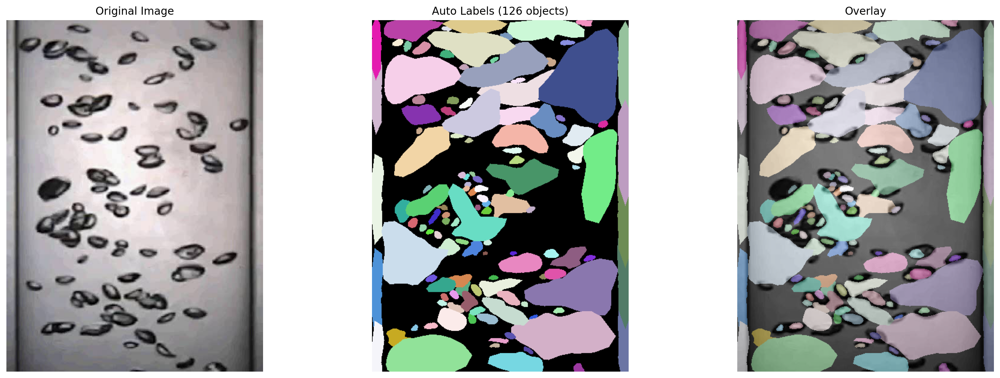

In [5]:
# Test trên 1 ảnh trước
test_img_path = image_files[0]
raw_img = np.array(Image.open(test_img_path))

# --- ĐOẠN SỬA LỖI ---
# Kiểm tra nếu ảnh có 3 chiều (RGB hoặc RGBA) thì chuyển về 2 chiều (Grayscale)
if raw_img.ndim == 3:
    print(f"⚠️ Ảnh gốc có shape {raw_img.shape} (RGB), đang chuyển về Grayscale...")
    # Cách đơn giản: Lấy trung bình cộng các kênh màu
    test_img = np.mean(raw_img, axis=2)
    
    # HOẶC: Nếu là ảnh hiển vi huỳnh quang xanh lá, bạn có thể chỉ lấy kênh Green:
    # test_img = raw_img[:, :, 1] 
else:
    test_img = raw_img
# --------------------

# Normalize ảnh (lúc này test_img đã chắc chắn là 2D)
test_img_norm = normalize(test_img, 1, 99.8, axis=(0, 1))

print(f"Testing on: {test_img_path.name} (Shape: {test_img.shape})")
labels, details = pretrained_model.predict_instances(test_img_norm)

n_objects = len(np.unique(labels)) - 1
print(f"Detected {n_objects} objects")

# Visualize
from stardist import random_label_cmap
lbl_cmap = random_label_cmap()

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Hiển thị ảnh gốc (nếu là 2D thì dùng cmap gray, nếu RGB thì để nguyên)
axes[0].imshow(raw_img, cmap='gray' if raw_img.ndim == 2 else None)
axes[0].set_title('Original Image')
axes[0].axis('off')

axes[1].imshow(labels, cmap=lbl_cmap)
axes[1].set_title(f'Auto Labels ({n_objects} objects)')
axes[1].axis('off')

# Overlay: Hiển thị labels đè lên ảnh gốc grayscale để dễ nhìn
axes[2].imshow(test_img, cmap='gray')
axes[2].imshow(labels, cmap=lbl_cmap, alpha=0.5)
axes[2].set_title('Overlay')
axes[2].axis('off')

plt.tight_layout()
plt.show()

In [6]:
# Điều chỉnh thresholds nếu cần
PROB_THRESH = 0.5  # Giảm xuống 0.3-0.4 nếu bỏ sót nhiều objects
NMS_THRESH = 0.4   # Tăng lên 0.5-0.6 nếu quá nhiều duplicates

print(f"Using thresholds: prob={PROB_THRESH}, nms={NMS_THRESH}")
print("\nĐể thử lại với thresholds khác nhau, xem cell dưới.")

Using thresholds: prob=0.5, nms=0.4

Để thử lại với thresholds khác nhau, xem cell dưới.


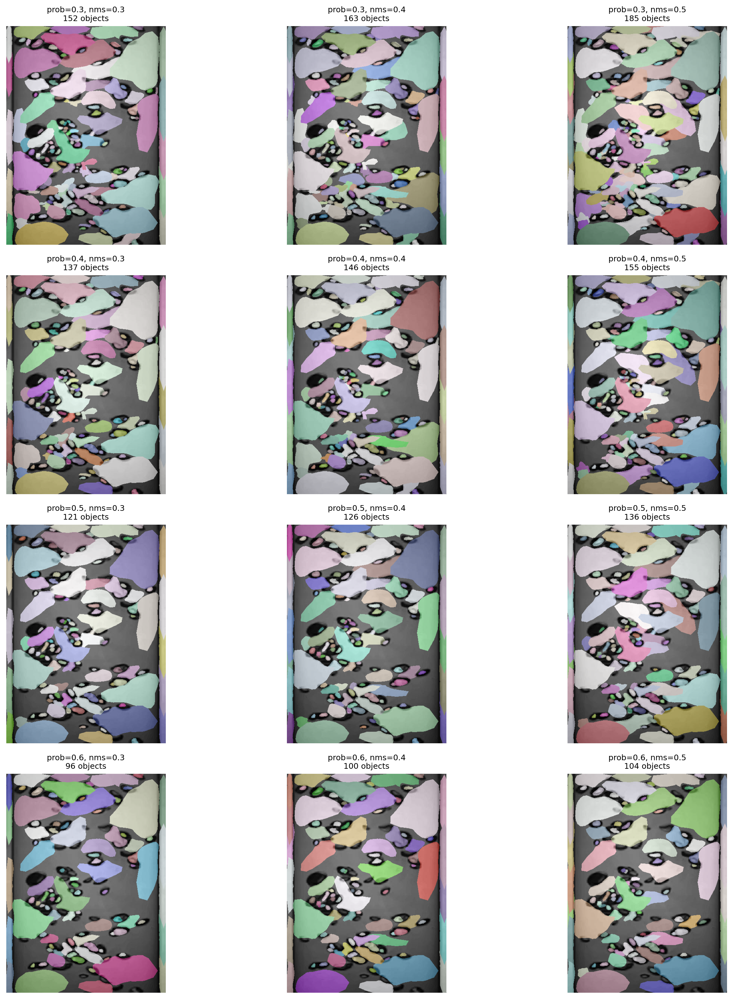


💡 Chọn combination tốt nhất và update PROB_THRESH, NMS_THRESH ở cell trên.


In [7]:
# OPTIONAL: Thử nhiều thresholds khác nhau trên 1 ảnh
test_img_norm = normalize(test_img, 1, 99.8, axis=(0, 1))

prob_threshs = [0.3, 0.4, 0.5, 0.6]
nms_threshs = [0.3, 0.4, 0.5]

fig, axes = plt.subplots(len(prob_threshs), len(nms_threshs), figsize=(15, 16))

for i, prob_th in enumerate(prob_threshs):
    for j, nms_th in enumerate(nms_threshs):
        labels_test, _ = pretrained_model.predict_instances(
            test_img_norm,
            prob_thresh=prob_th,
            nms_thresh=nms_th
        )
        n_obj = len(np.unique(labels_test)) - 1
        
        axes[i, j].imshow(test_img, cmap='gray' if test_img.ndim == 2 else None)
        axes[i, j].imshow(labels_test, cmap=lbl_cmap, alpha=0.5)
        axes[i, j].set_title(f"prob={prob_th}, nms={nms_th}\n{n_obj} objects", fontsize=9)
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

print("\n💡 Chọn combination tốt nhất và update PROB_THRESH, NMS_THRESH ở cell trên.")

In [8]:
from tqdm import tqdm
import numpy as np
from PIL import Image
from csbdeep.utils import normalize

# Đảm bảo bạn đã định nghĩa ngưỡng (nếu chưa có thì dùng mặc định)
# PROB_THRESH = 0.5
# NMS_THRESH = 0.3

print(f"Processing {len(image_files)} images with pre-trained StarDist...\n")

for img_file in tqdm(image_files, desc="Auto-annotating"):
    # 1. Load ảnh gốc
    raw_img = np.array(Image.open(img_file))
    
    # --- PHẦN SỬA LỖI QUAN TRỌNG ---
    # Kiểm tra dimension: Nếu là 3D (RGB/RGBA) -> Chuyển thành 2D (Grayscale)
    if raw_img.ndim == 3:
        # Nếu là ảnh RGBA (4 kênh), bỏ kênh Alpha đi trước
        if raw_img.shape[-1] == 4:
            raw_img = raw_img[..., :3]
        
        # Tính trung bình cộng để ra ảnh xám
        img = np.mean(raw_img, axis=2)
    else:
        img = raw_img
    # -------------------------------

    # 2. Normalize (lúc này img chắc chắn là 2D)
    img_norm = normalize(img, 1, 99.8, axis=(0, 1))
    
    # 3. Predict
    labels, _ = pretrained_model.predict_instances(
        img_norm,
        prob_thresh=PROB_THRESH,
        nms_thresh=NMS_THRESH
    )
    
    # 4. Lưu mask
    mask_path = masks_dir / img_file.name
    
    # Lưu dạng uint16 (chuẩn cho label images)
    if labels.max() < 65536:
        Image.fromarray(labels.astype(np.uint16)).save(mask_path)
    else:
        # Rất hiếm khi > 65k cells, nhưng phòng hờ
        Image.fromarray(labels.astype(np.uint32)).save(mask_path)

print(f"\n✅ DONE! Auto-annotations saved to: {masks_dir}")
print(f"\n📝 BƯỚC TIẾP THEO:")
print(f"   1. Kiểm tra kết quả bằng cell dưới")
print(f"   2. Nếu tốt → Chạy cell cuối cùng của notebook 0_prepare_my_data.ipynb để chia train/val")
print(f"   3. Nếu có lỗi → Mở Fiji để chỉnh sửa (nhanh hơn nhiều so với vẽ từ đầu!)")

Processing 40 images with pre-trained StarDist...



Auto-annotating: 100%|██████████| 40/40 [00:22<00:00,  1.78it/s]


✅ DONE! Auto-annotations saved to: my_dataset\to_annotate\masks

📝 BƯỚC TIẾP THEO:
   1. Kiểm tra kết quả bằng cell dưới
   2. Nếu tốt → Chạy cell cuối cùng của notebook 0_prepare_my_data.ipynb để chia train/val
   3. Nếu có lỗi → Mở Fiji để chỉnh sửa (nhanh hơn nhiều so với vẽ từ đầu!)


---
# PHƯƠNG PHÁP 2: CELLPOSE (MẠNH MẼ)

Cellpose là model deep learning mạnh mẽ, có thể detect nhiều loại cells/objects.

**Cài đặt:**
```bash
pip install cellpose
```

In [ ]:
# Cài Cellpose nếu chưa có
# !pip install cellpose

try:
    from cellpose import models
    
    # Load model
    # Models: 'cyto', 'nuclei', 'cyto2', 'cyto3'
    cellpose_model = models.Cellpose(gpu=True, model_type='cyto2')
    
    print("✅ Cellpose loaded!")
    
    # Test trên 1 ảnh
    test_img = np.array(Image.open(image_files[0]))
    
    # Predict
    masks, flows, styles, diams = cellpose_model.eval(
        test_img,
        diameter=None,  # Auto-detect diameter
        channels=[0, 0],  # Grayscale: [0,0], RGB: [2,3]
    )
    
    n_objects = len(np.unique(masks)) - 1
    print(f"Detected {n_objects} objects")
    
    # Visualize
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(test_img, cmap='gray' if test_img.ndim == 2 else None)
    axes[0].set_title('Original')
    axes[0].axis('off')
    
    axes[1].imshow(masks, cmap=lbl_cmap)
    axes[1].set_title(f'Cellpose ({n_objects} objects)')
    axes[1].axis('off')
    
    axes[2].imshow(test_img, cmap='gray' if test_img.ndim == 2 else None)
    axes[2].imshow(masks, cmap=lbl_cmap, alpha=0.5)
    axes[2].set_title('Overlay')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()
    
except ImportError:
    print("⚠️ Cellpose chưa được cài đặt.")
    print("   Để sử dụng Cellpose, chạy: pip install cellpose")

In [ ]:
# XỬ LÝ TẤT CẢ với Cellpose
try:
    from cellpose import models
    cellpose_model = models.Cellpose(gpu=True, model_type='cyto2')
    
    print(f"Processing {len(image_files)} images with Cellpose...\n")
    
    for img_file in tqdm(image_files, desc="Cellpose annotation"):
        img = np.array(Image.open(img_file))
        
        masks, _, _, _ = cellpose_model.eval(
            img,
            diameter=None,
            channels=[0, 0],
        )
        
        # Lưu
        mask_path = masks_dir / img_file.name
        if masks.max() < 65536:
            Image.fromarray(masks.astype(np.uint16)).save(mask_path)
        else:
            Image.fromarray(masks.astype(np.uint32)).save(mask_path)
    
    print(f"\n✅ Cellpose annotations saved to: {masks_dir}")
    
except ImportError:
    print("⚠️ Cellpose not installed. Skip this method.")

---
# PHƯƠNG PHÁP 3: TRADITIONAL CV (Threshold + Watershed)

Sử dụng các kỹ thuật Computer Vision truyền thống.

**Ưu điểm:**
- Không cần GPU
- Rất nhanh
- Tốt cho objects đơn giản, tách biệt rõ

**Nhược điểm:**
- Kém với objects chồng lấp
- Cần điều chỉnh tham số

In [ ]:
from scipy import ndimage as ndi
from skimage import filters, morphology, segmentation, measure
from skimage.feature import peak_local_max

def traditional_segmentation(img, min_size=50, sigma=2):
    """
    Segmentation bằng Threshold + Watershed
    
    Parameters:
    - min_size: Kích thước object tối thiểu (pixels)
    - sigma: Gaussian blur sigma
    """
    # Normalize
    if img.max() > 1:
        img = img.astype(float) / img.max()
    
    # Gaussian blur để giảm noise
    img_smooth = filters.gaussian(img, sigma=sigma)
    
    # Threshold (Otsu)
    thresh = filters.threshold_otsu(img_smooth)
    binary = img_smooth > thresh
    
    # Morphological operations
    binary = morphology.remove_small_objects(binary, min_size=min_size)
    binary = morphology.remove_small_holes(binary, area_threshold=min_size)
    
    # Distance transform
    distance = ndi.distance_transform_edt(binary)
    
    # Find peaks (seeds for watershed)
    local_max = peak_local_max(
        distance,
        min_distance=int(np.sqrt(min_size)),
        labels=binary
    )
    
    # Create markers
    markers = np.zeros_like(binary, dtype=int)
    markers[tuple(local_max.T)] = np.arange(1, len(local_max) + 1)
    markers = morphology.dilation(markers, morphology.disk(2))
    
    # Watershed
    labels = segmentation.watershed(-distance, markers, mask=binary)
    
    return labels

# Test
test_img = np.array(Image.open(image_files[0]))
if test_img.ndim == 3:
    test_img = test_img.mean(axis=2)  # Convert to grayscale

labels_cv = traditional_segmentation(test_img, min_size=50, sigma=2)
n_objects = len(np.unique(labels_cv)) - 1

print(f"Detected {n_objects} objects using traditional CV")

# Visualize
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(test_img, cmap='gray')
axes[0].set_title('Original')
axes[0].axis('off')

axes[1].imshow(labels_cv, cmap=lbl_cmap)
axes[1].set_title(f'Traditional CV ({n_objects} objects)')
axes[1].axis('off')

axes[2].imshow(test_img, cmap='gray')
axes[2].imshow(labels_cv, cmap=lbl_cmap, alpha=0.5)
axes[2].set_title('Overlay')
axes[2].axis('off')

plt.tight_layout()
plt.show()

print("\n💡 Nếu kết quả tốt, chạy cell tiếp để xử lý tất cả ảnh.")
print("   Nếu không tốt, thử điều chỉnh min_size và sigma.")

In [ ]:
# Điều chỉnh tham số
MIN_SIZE = 50   # Tăng nếu có nhiều noise nhỏ
SIGMA = 2       # Tăng nếu ảnh nhiều noise

print(f"Using parameters: min_size={MIN_SIZE}, sigma={SIGMA}")

In [ ]:
# XỬ LÝ TẤT CẢ với Traditional CV
print(f"Processing {len(image_files)} images with Traditional CV...\n")

for img_file in tqdm(image_files, desc="Traditional CV annotation"):
    img = np.array(Image.open(img_file))
    if img.ndim == 3:
        img = img.mean(axis=2)
    
    labels = traditional_segmentation(img, min_size=MIN_SIZE, sigma=SIGMA)
    
    # Lưu
    mask_path = masks_dir / img_file.name
    if labels.max() < 65536:
        Image.fromarray(labels.astype(np.uint16)).save(mask_path)
    else:
        Image.fromarray(labels.astype(np.uint32)).save(mask_path)

print(f"\n✅ Traditional CV annotations saved to: {masks_dir}")

---
# KIỂM TRA KẾT QUẢ AUTO-ANNOTATION

Xem một số kết quả để đánh giá chất lượng

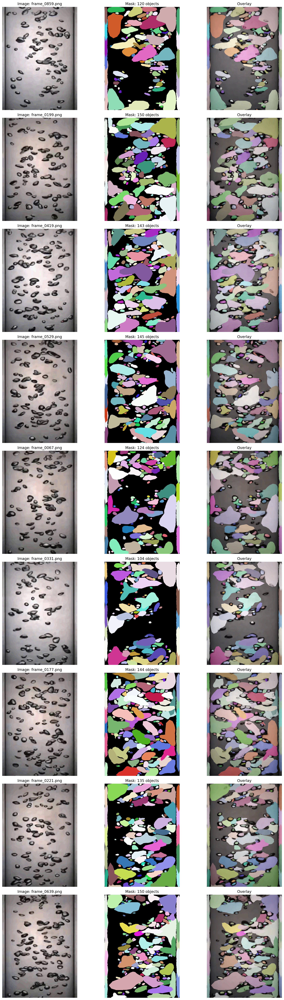


AUTO-ANNOTATION STATISTICS
Total masks created: 40
Total objects detected: 5454
Average objects per image: 136.3 ± 14.7
Min/Max objects: 101 / 169


In [13]:
# Xem 9 samples ngẫu nhiên
mask_files = sorted(masks_dir.glob('*.png')) + sorted(masks_dir.glob('*.tif'))

if len(mask_files) == 0:
    print("⚠️ Chưa có masks! Chạy một trong các phương pháp auto-annotation ở trên.")
else:
    n_samples = min(9, len(mask_files))
    sample_indices = np.random.choice(len(mask_files), n_samples, replace=False)
    
    fig, axes = plt.subplots(n_samples, 3, figsize=(15, 5*n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)
    
    for i, idx in enumerate(sample_indices):
        mask_file = mask_files[idx]
        img_file = images_dir / mask_file.name
        
        img = np.array(Image.open(img_file))
        mask = np.array(Image.open(mask_file))
        n_objects = len(np.unique(mask)) - 1
        
        # Original
        axes[i, 0].imshow(img, cmap='gray' if img.ndim == 2 else None)
        axes[i, 0].set_title(f"Image: {img_file.name}")
        axes[i, 0].axis('off')
        
        # Mask
        axes[i, 1].imshow(mask, cmap=lbl_cmap)
        axes[i, 1].set_title(f"Mask: {n_objects} objects")
        axes[i, 1].axis('off')
        
        # Overlay
        axes[i, 2].imshow(img, cmap='gray' if img.ndim == 2 else None)
        axes[i, 2].imshow(mask, cmap=lbl_cmap, alpha=0.5)
        axes[i, 2].set_title('Overlay')
        axes[i, 2].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Statistics
    all_counts = []
    for mask_file in mask_files:
        mask = np.array(Image.open(mask_file))
        all_counts.append(len(np.unique(mask)) - 1)
    
    print(f"\n{'='*60}")
    print("AUTO-ANNOTATION STATISTICS")
    print(f"{'='*60}")
    print(f"Total masks created: {len(mask_files)}")
    print(f"Total objects detected: {sum(all_counts)}")
    print(f"Average objects per image: {np.mean(all_counts):.1f} ± {np.std(all_counts):.1f}")
    print(f"Min/Max objects: {min(all_counts)} / {max(all_counts)}")

## 🎯 HƯỚNG DẪN ĐÁNH GIÁ KẾT QUẢ

Sau khi chạy cell trên, bạn sẽ thấy:

### 1️⃣ **Xem ảnh mẫu:**
Quan sát 9 ảnh được hiển thị và tự hỏi:
- ❓ Có objects nào bị bỏ sót không?
- ❓ Có vùng không phải object nhưng bị nhận diện nhầm không?
- ❓ Các objects có được tách rời đúng không? (không dính vào nhau)
- ❓ Đường viền có chính xác không?

### 2️⃣ **Xem thống kê:**
- Nếu "Average objects per image" hợp lý → Tốt
- Nếu quá cao hoặc quá thấp so với thực tế → Cần điều chỉnh

### 3️⃣ **Quyết định:**

**Nếu >80% chính xác:**
```python
# ✅ Dùng luôn! Chạy cell tiếp theo để tiếp tục
# Quay lại notebook 0_prepare_my_data.ipynb
# Chạy cell cuối (chia train/val)
```

**Nếu 50-80% chính xác:**
- Mở thư mục `my_dataset/to_annotate/masks/` trong Fiji
- Sửa những ảnh có lỗi rõ ràng (nhanh!)
- Không cần sửa tất cả, chỉ sửa những chỗ sai nhiều

**Nếu <50% chính xác:**
- Thử điều chỉnh `PROB_THRESH` và `NMS_THRESH` (quay lên cell số 7)
- Hoặc thử phương pháp khác (Cellpose, Traditional CV)
- Worst case: Gán nhãn thủ công theo `HUONG_DAN_FIJI.md`

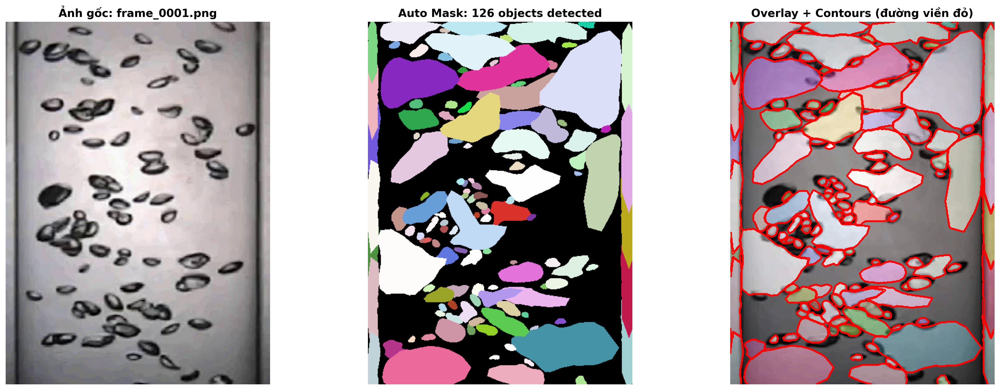


📊 Chi tiết ảnh: frame_0001.png
   - Số objects: 126
   - Kích thước: (588, 428, 3)
   - Object IDs: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]...

💡 Để xem ảnh khác, thay đổi INDEX_TO_CHECK ở trên (0, 1, 2, ...)
   Tổng có 40 ảnh

🔍 ĐÁNH GIÁ NHANH:
   ✅ Số objects trong khoảng hợp lý
   → Xem kỹ overlay để đánh giá chất lượng


In [12]:
# TOOL: So sánh ảnh gốc với mask chi tiết hơn
# Chọn 1 ảnh cụ thể để xem kỹ

if len(mask_files) > 0:
    # Chọn ảnh thứ mấy muốn xem (đếm từ 0)
    INDEX_TO_CHECK = 0  # Thay số này để xem ảnh khác (0, 1, 2, ...)
    
    img_file = sorted(images_dir.glob('*.png'))[INDEX_TO_CHECK]
    mask_file = masks_dir / img_file.name
    
    if mask_file.exists():
        img = np.array(Image.open(img_file))
        mask = np.array(Image.open(mask_file))
        n_objects = len(np.unique(mask)) - 1
        
        # Tạo figure lớn để xem rõ
        fig = plt.figure(figsize=(20, 7))
        
        # Ảnh gốc
        ax1 = plt.subplot(131)
        ax1.imshow(img, cmap='gray' if img.ndim == 2 else None)
        ax1.set_title(f'Ảnh gốc: {img_file.name}', fontsize=14, fontweight='bold')
        ax1.axis('off')
        
        # Mask
        ax2 = plt.subplot(132)
        ax2.imshow(mask, cmap=lbl_cmap)
        ax2.set_title(f'Auto Mask: {n_objects} objects detected', fontsize=14, fontweight='bold')
        ax2.axis('off')
        
        # Overlay với contours
        ax3 = plt.subplot(133)
        ax3.imshow(img, cmap='gray' if img.ndim == 2 else None)
        ax3.imshow(mask, cmap=lbl_cmap, alpha=0.4)
        
        # Vẽ contours để thấy rõ đường viền
        from skimage.segmentation import find_boundaries
        boundaries = find_boundaries(mask, mode='outer')
        ax3.contour(boundaries, colors='red', linewidths=1.5)
        ax3.set_title('Overlay + Contours (đường viền đỏ)', fontsize=14, fontweight='bold')
        ax3.axis('off')
        
        plt.tight_layout()
        plt.show()
        
        print(f"\n📊 Chi tiết ảnh: {img_file.name}")
        print(f"   - Số objects: {n_objects}")
        print(f"   - Kích thước: {img.shape}")
        print(f"   - Object IDs: {np.unique(mask)[:20]}{'...' if len(np.unique(mask)) > 20 else ''}")
        print(f"\n💡 Để xem ảnh khác, thay đổi INDEX_TO_CHECK ở trên (0, 1, 2, ...)")
        print(f"   Tổng có {len(mask_files)} ảnh")
        
        # Đánh giá tự động
        print(f"\n🔍 ĐÁNH GIÁ NHANH:")
        if n_objects == 0:
            print("   ⚠️ CẢNH BÁO: Không detect được object nào!")
            print("   → Thử giảm PROB_THRESH xuống 0.3 hoặc 0.4")
        elif n_objects < 5:
            print("   ⚠️ Số objects rất ít. Kiểm tra xem có bỏ sót không?")
        elif n_objects > 500:
            print("   ⚠️ Số objects rất nhiều. Có thể detect nhầm noise?")
            print("   → Thử tăng PROB_THRESH lên 0.6 hoặc 0.7")
        else:
            print("   ✅ Số objects trong khoảng hợp lý")
            print("   → Xem kỹ overlay để đánh giá chất lượng")
    else:
        print(f"⚠️ Không tìm thấy mask cho {img_file.name}")
else:
    print("⚠️ Chưa có masks! Chạy phương pháp auto-annotation trước.")

---
# 🔧 CHỈNH SỬA MASKS TRONG FIJI (NẾU CẦN)

Nếu auto-annotations có lỗi, bạn có thể mở trong Fiji để chỉnh sửa:

## Cách chỉnh sửa nhanh:

1. **Mở mask trong Fiji:**
   ```
   File → Open → Chọn mask từ my_dataset/to_annotate/masks/
   ```

2. **Chỉnh sửa:**
   - **Xóa object sai**: Dùng Pencil tool, set value = 0, vẽ lên object đó
   - **Thêm object**: Dùng Selection tool vẽ object mới, Process → Math → Set... → Value = (ID_mới)
   - **Tách objects**: Dùng Pencil với value = 0 để vẽ đường ngăn cách

3. **Lưu lại:**
   ```
   File → Save (Ctrl+S)
   ```

## Tips:
- Zoom in bằng `+` để xem rõ
- Dùng `Image → Lookup Tables → Fire` để xem rõ các objects
- Chỉ cần sửa những chỗ sai rõ ràng, không cần hoàn hảo 100%

---
# ✅ KẾT LUẬN VÀ BƯỚC TIẾP THEO

## 🎯 So sánh các phương pháp:

| Phương pháp | Tốc độ | Chất lượng | GPU | Khuyến nghị |
|-------------|--------|------------|-----|-------------|
| **Pre-trained StarDist** | ⭐⭐⭐ | ⭐⭐⭐ | Không bắt buộc | **KHUYẾN NGHỊ** |
| **Cellpose** | ⭐⭐ | ⭐⭐⭐⭐ | Khuyến nghị | Tốt cho cells |
| **Traditional CV** | ⭐⭐⭐ | ⭐⭐ | Không | Tốt cho objects đơn giản |
| **Thủ công (Fiji)** | ⭐ | ⭐⭐⭐⭐⭐ | Không | Chậm nhưng chính xác nhất |

## 📝 WORKFLOW ĐỀ XUẤT:

```
1. Chạy Pre-trained StarDist (NHANH)
   ↓
2. Kiểm tra kết quả
   ↓
3a. Nếu tốt (>80% đúng):
    → Dùng luôn, có thể sửa một vài chỗ trong Fiji
    → Chạy training ngay
   
3b. Nếu trung bình (50-80% đúng):
    → Mở Fiji, chỉnh sửa những chỗ sai
    → Nhanh hơn nhiều so với vẽ từ đầu!
   
3c. Nếu kém (<50% đúng):
    → Thử Cellpose hoặc Traditional CV
    → Hoặc điều chỉnh thresholds
    → Worst case: Gán nhãn thủ công
```

## 🚀 BƯỚC TIẾP THEO:

1. **Nếu hài lòng với auto-annotations:**
   ```python
   # Quay lại notebook 0_prepare_my_data.ipynb
   # Chạy cell cuối cùng (Cell 6) để chia train/validation
   ```

2. **Sau đó training:**
   ```python
   # Mở notebook 1_training_my_data.ipynb
   # Chạy training
   ```

3. **Iterative improvement:**
   - Train với auto-annotations → Xem kết quả
   - Sửa annotations ở những ảnh model dự đoán kém
   - Train lại → Cải thiện dần

## 💡 TIPS:

- **Không cần annotations hoàn hảo 100%** để bắt đầu training
- Annotations 80-90% chính xác đã đủ tốt
- Iterative improvement tốt hơn là chờ annotations hoàn hảo
- Model sẽ học được pattern chung từ dữ liệu có noise

---

**Chúc bạn thành công!** 🎉